In [11]:
%load_ext autoreload
%autoreload 2
from typing import Tuple
import numpy as np

import PIL
from PIL import Image
#from pymagsac import pymagsac
from scipy.ndimage import uniform_filter, variance

from torch import onnx
from torch.nn.utils import prune

from rasterio.crs import CRS
from rasterio import transform as tform
import torch.onnx.utils
import rasterio as rio
from rasterio import warp
import matplotlib
from matplotlib import pyplot as plt

import argparse
import pytorch_lightning as pl

# Need thsxdfsdfis to plot in HD
# This takes up a lot of memory!
matplotlib.rcParams['figure.dpi'] = 100



The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [12]:
from tester import Tester

class Tester_Pytorch_TopicFM(Tester):
        def __init__(self,matcher,device="cuda"):
            super().__init__()
            self.name_model= "TopicFM"
            self.matcher = matcher.to(device)#get_matcher()
            self.device=device
        def make_inference(self,image0:np.numarray,image1:np.numarray)->Tuple[np.numarray,np.numarray,np.numarray]:
            m1,m2,c =   self.matcher.matcher(torch.from_numpy(image0).to(self.device),torch.from_numpy(image1).to(self.device))
            return m1.cpu().numpy(),m2.cpu().numpy(),c.cpu().numpy()
class Tester_ONNX(Tester):
        def __init__(self,matcher):
            super().__init__()
            self.name_model= "TopicFM_ONNX"
            self.matcher = matcher#get_matcher()

        def make_inference(self,image0:np.numarray,image1:np.numarray)->Tuple[np.numarray,np.numarray,np.numarray]:
            mkpts0 ,mkpts1,mconf = self.matcher.run(None, {"image0": image0,"image1": image1})
            return mkpts0 ,mkpts1,mconf
class Tester_Pytorch_MatchFormer(Tester):
        def __init__(self,matcher,device):
            super().__init__()
            self.name_model= "MarchFormer"
            self.matcher = matcher.to(device)#get_matcher()
            self.device=device
        def make_inference(self,image0:np.numarray,image1:np.numarray)->Tuple[np.numarray,np.numarray,np.numarray]:

            batch = {'image0': torch.from_numpy(image0).to(self.device), 'image1': torch.from_numpy(image1).to(self.device)}

            self.matcher.matcher(batch)
            mkpts0 = batch['mkpts0_f'].cpu().numpy()
            mkpts1 = batch['mkpts1_f'].cpu().numpy()
            mconf = batch['mconf'].cpu().numpy()

            return mkpts0 ,mkpts1,mconf
class Tester_PyTorch_ASpanFormer(Tester):
        def __init__(self,matcher,device):
            super().__init__()
            self.name_model= "ASpanFormer"
            self.matcher = matcher.to(device)#get_matcher()
            self.device=device
        def make_inference(self,image0:np.numarray,image1:np.numarray)->Tuple[np.numarray,np.numarray,np.numarray]:

            batch = {'image0': torch.from_numpy(image0).to(self.device), 'image1': torch.from_numpy(image1).to(self.device)}

            self.matcher.matcher(batch)
            mkpts0 = batch['mkpts0_f'].cpu().numpy()
            mkpts1 = batch['mkpts1_f'].cpu().numpy()
            mconf = batch['mconf'].cpu().numpy()

            return mkpts0 ,mkpts1,mconf

class Tester_Pytorch_LoFTR(Tester):
        def __init__(self,matcher,device):
            super().__init__()
            self.name_model= "LoFTR"
            self.matcher = matcher.to(device)#get_matcher()
            self.device=device
        def make_inference(self,image0:np.numarray,image1:np.numarray)->Tuple[np.numarray,np.numarray,np.numarray]:
            batch = {'image0': torch.from_numpy(image0).to(self.device), 'image1': torch.from_numpy(image1).to(self.device)}
            self.matcher(batch)
            mkpts0 = batch['mkpts0_f'].cpu().numpy()
            mkpts1 = batch['mkpts1_f'].cpu().numpy()
            mconf = batch['mconf'].cpu().numpy()
            return mkpts0 ,mkpts1,mconf


import random
import numpy as np

def add_channel(arr):
    """
    Adds a new channel of zeros to a numpy array of shape (channels,h,w).

    Parameters:
    arr (numpy.ndarray): The input array with shape (channels,h,w).

    Returns:
    numpy.ndarray: The output array with shape (channels+1,h,w).
    """
    # Get the number of channels, height, and width of the input array
    channels, h, w = arr.shape

    # Create a new numpy array with an extra channel of zeros
    new_arr = np.zeros((channels+1, h, w))+0.5

    # Copy the input array into the new array, leaving the new channel as zeros
    new_arr[:-1, :, :] = arr

    return new_arr
from FlowFormer.core.utils import flow_viz
class Tester_Pytorch_FlowFormer(Tester):
        def __init__(self,matcher,device):
            super().__init__()
            self.name_model= "FlowFormer"

            self.matcher = matcher.to(device)#get_matcher()
            self.device=device
        def make_inference(self, image0: np.ndarray, image1: np.ndarray) -> Tuple[np.ndarray, np.ndarray, np.ndarray]:
            img0 = torch.as_tensor(image0, device=self.device).repeat(1, 3, 1, 1)
            img1 = torch.as_tensor(image1, device=self.device).repeat(1, 3, 1, 1)
            flow_pre, _ = self.matcher(img0, img1)

            flow_pre_cpu = flow_pre.cpu().squeeze().permute(1, 2, 0).numpy()
            flow_img = flow_viz.flow_to_image(flow_pre_cpu)
            plt.imshow(flow_img)
            plt.show()

            mask = torch.rand_like(flow_pre[0, 0]) > 0.95
            idx = torch.nonzero(mask)

            # extract correspondence points and confidence values
            mkpts0 = idx.cpu().numpy()
            mkpts1 = mkpts0 + flow_pre[0, :2, idx[:, 0], idx[:, 1]].cpu().numpy().T
            mconf = np.full((len(mkpts0),), 0.98)

            return mkpts0, mkpts1, mconf

In [13]:
from TopicFM.get_matcher import get_matcher as get_matcher_TopicFM
from MatchFormer.get_matcher import get_matcher as get_matcher_MatchFormer
from LoFTR_master.get_matcher import get_matcher as get_matcher_LoFTR
from ASpanFormer.get_matcher import get_matcher as get_matcher_ASpanFormer
from FlowFormer.get_matcher import get_matcher as get_matcher_FlowFormer

In [14]:
#tester_py = Tester_Pytorch_FlowFormer(get_matcher_FlowFormer(path="../FlowFormer/weights/things_kitti.pth",small="False"),"cuda")
#tester_py.make_test(size_search=(640, 640),angle_rotation=0)
#assert False

Global seed set to 66
2023-04-27 18:40:35.922 | INFO     | TopicFM.src.lightning_trainer.trainer:__init__:49 - Load '../TopicFM/pretrained/model_best.ckpt' as pretrained checkpoint


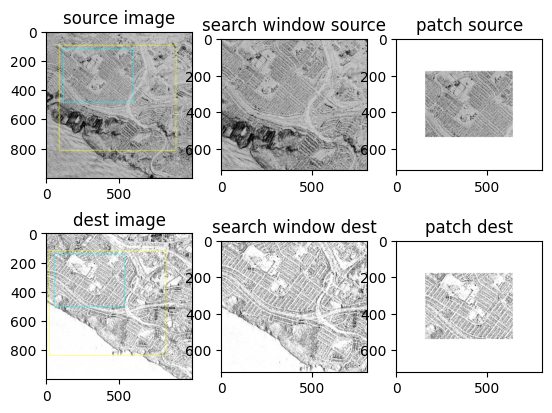

Single inference Execution time: 1.2817680835723877 s
{'min_samples': 0, 'residual_threshold': -1, 'max_trials': 0, 'rmse': 647.8055263734634, 'inliers': 1086}
{'min_samples': 4, 'residual_threshold': 1, 'max_trials': 100, 'rmse': -1, 'inliers': 8}
{'min_samples': 4, 'residual_threshold': 1.5, 'max_trials': 100, 'rmse': 11.36221809331259, 'inliers': 22}
{'min_samples': 4, 'residual_threshold': 2, 'max_trials': 100, 'rmse': 6.395310782127793, 'inliers': 57}
{'min_samples': 4, 'residual_threshold': 2.5, 'max_trials': 100, 'rmse': 6.024948132556827, 'inliers': 105}
{'min_samples': 4, 'residual_threshold': 3, 'max_trials': 100, 'rmse': 7.635443667528429, 'inliers': 172}


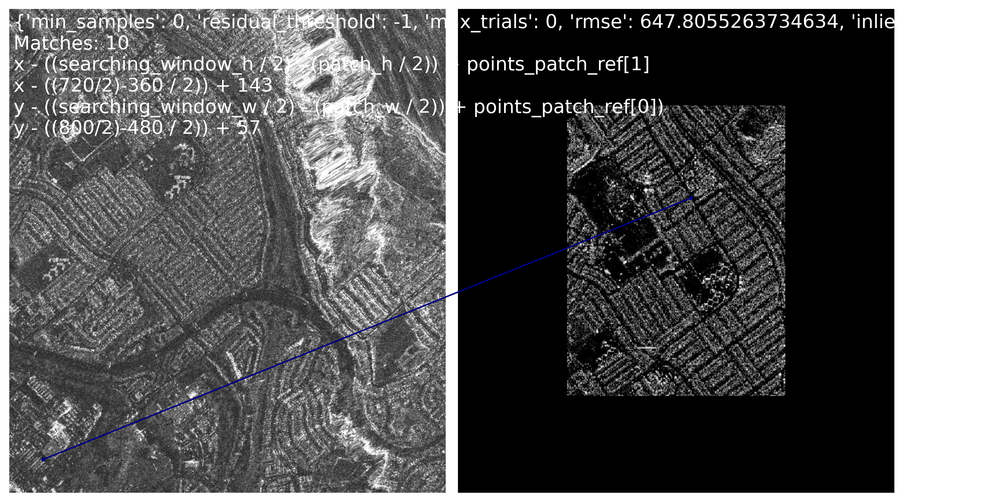

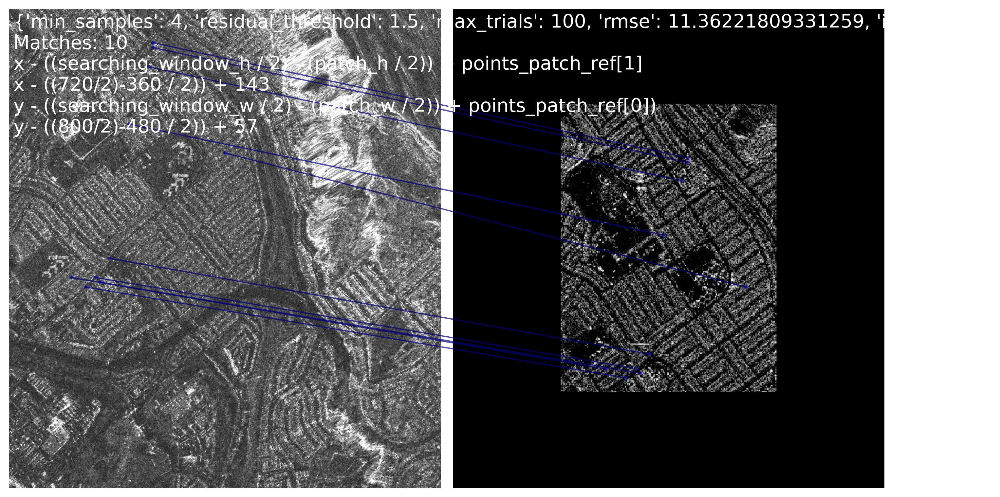

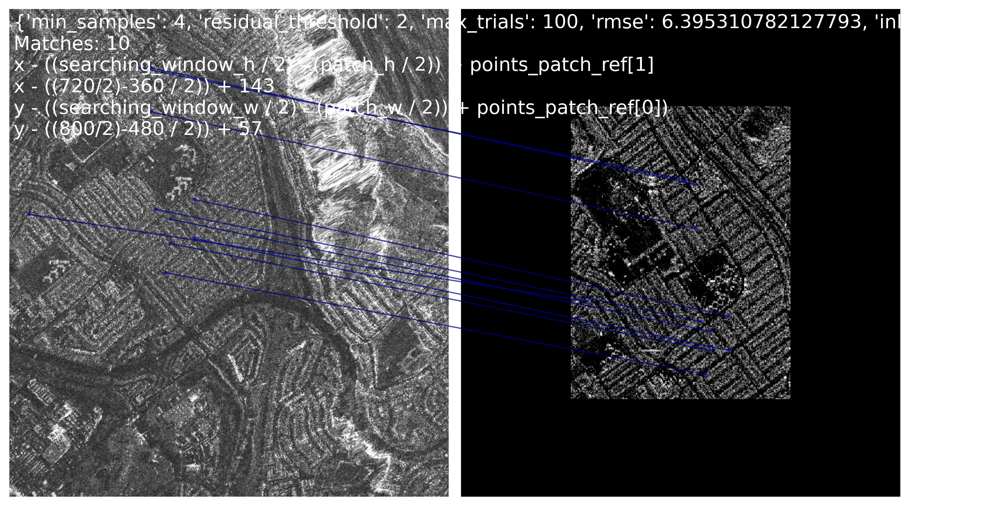

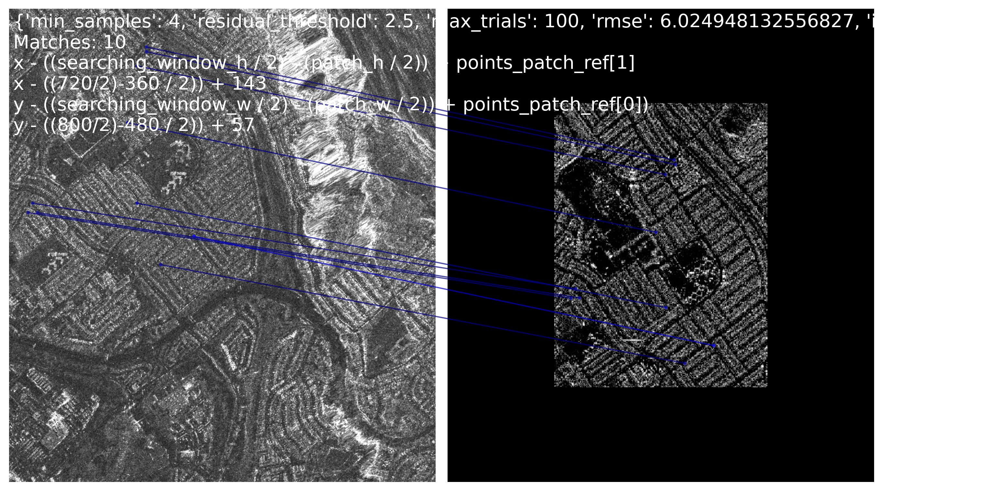

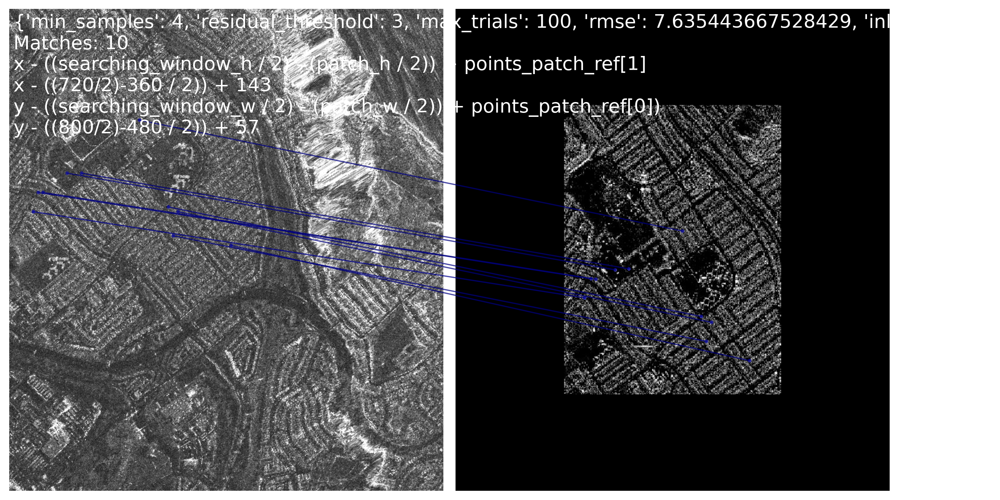

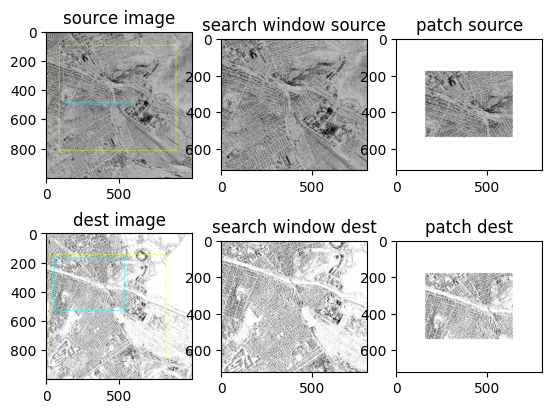

Single inference Execution time: 2.2994842529296875 s
{'min_samples': 0, 'residual_threshold': -1, 'max_trials': 0, 'rmse': 337.64034119162955, 'inliers': 1190}
{'min_samples': 4, 'residual_threshold': 1, 'max_trials': 100, 'rmse': 5.656854249492381, 'inliers': 12}
{'min_samples': 4, 'residual_threshold': 1.5, 'max_trials': 100, 'rmse': 5.310367218940701, 'inliers': 24}
{'min_samples': 4, 'residual_threshold': 2, 'max_trials': 100, 'rmse': 12.30447073221762, 'inliers': 50}
{'min_samples': 4, 'residual_threshold': 2.5, 'max_trials': 100, 'rmse': 6.4265076052238514, 'inliers': 91}
{'min_samples': 4, 'residual_threshold': 3, 'max_trials': 100, 'rmse': 9.192388155425117, 'inliers': 150}


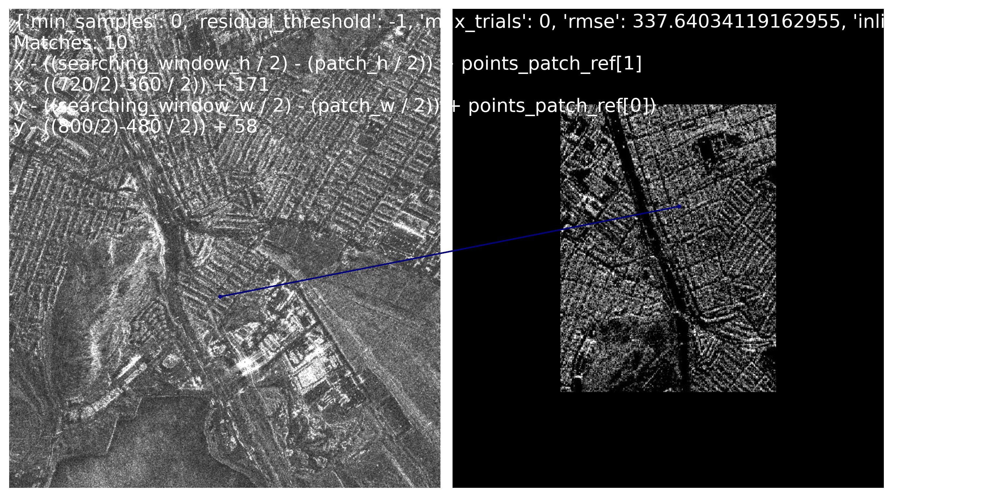

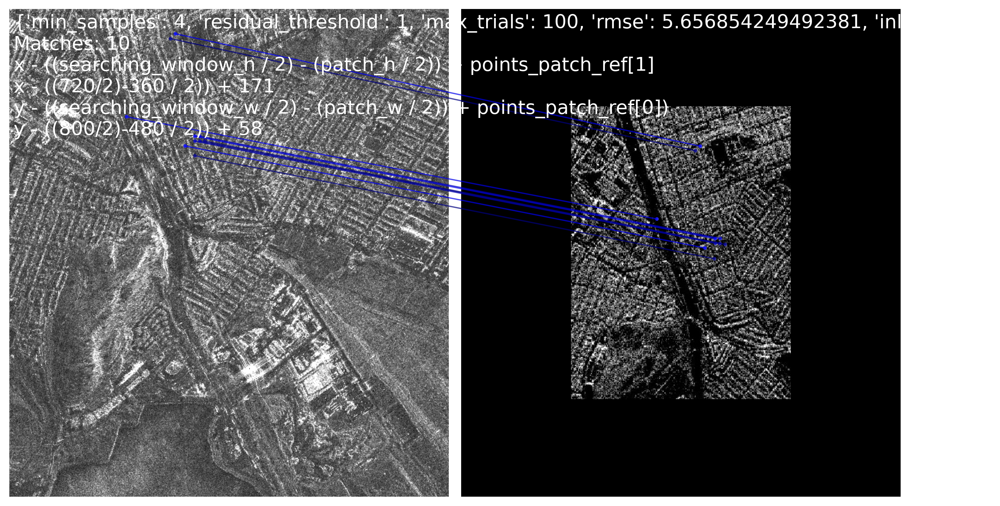

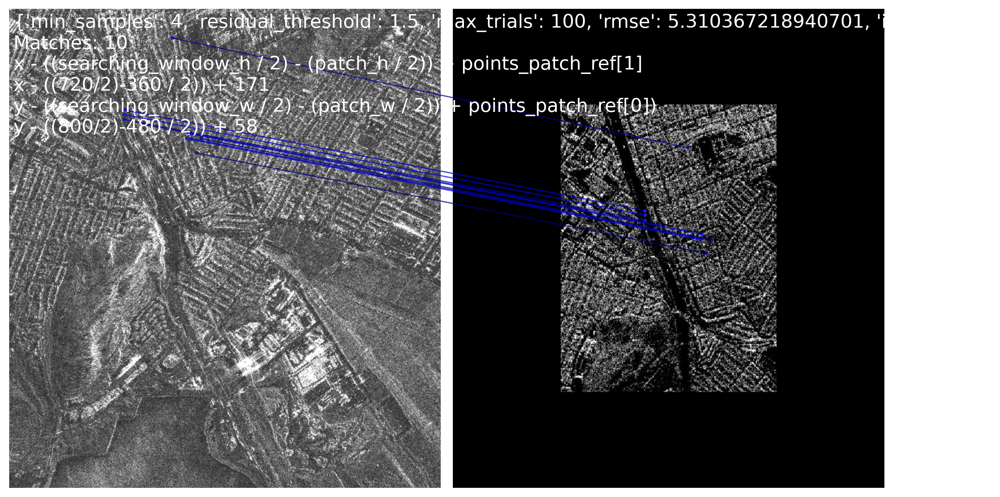

Unexpected exception formatting exception. Falling back to standard exception


Traceback (most recent call last):
  File "/home/fred/anaconda3/envs/pythonProject/lib/python3.10/site-packages/PIL/ImageFile.py", line 518, in _save
    fh = fp.fileno()
AttributeError: '_idat' object has no attribute 'fileno'

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/fred/anaconda3/envs/pythonProject/lib/python3.10/site-packages/IPython/core/interactiveshell.py", line 3433, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "/home/fred/PycharmProjects/Pretrained_UAV_Localization/Tester/ipykernel_2793/1691290712.py", line 2, in <module>
    tester_py.make_test(size_search=(800, 720),angle_rotation=0)
  File "/home/fred/PycharmProjects/Pretrained_UAV_Localization/Tester/tester.py", line 580, in make_test
    results, entropy = do_test(self.make_inference, ph, size_search=size_search,
  File "/home/fred/PycharmProjects/Pretrained_UAV_Localization/Tester/tester.py", line 507, in do_test
   

In [15]:
tester_py = Tester_Pytorch_TopicFM(get_matcher_TopicFM(),"cuda")
tester_py.make_test(size_search=(800, 720),angle_rotation=0)

assert False
tester_py.make_test(size_search=(800, 720),angle_rotation=5)
tester_py.make_test(size_search=(880, 880),angle_rotation=0)

tester_py.make_test(size_search=(800, 720),angle_rotation=10)
tester_py.make_test(size_search=(800, 720),angle_rotation=20)
tester_py.make_test(size_search=(800, 720),angle_rotation=30)
tester_py.make_test(size_search=(720, 640),angle_rotation=0)



In [ ]:
tester_py = Tester_Pytorch_MatchFormer(get_matcher_MatchFormer(),"cuda")
tester_py.make_test()

In [ ]:
tester_py = Tester_Pytorch_LoFTR(get_matcher_LoFTR(),"cuda")
tester_py.make_test()

In [ ]:
#tester_py = Tester_PyTorch_ASpanFormer(get_matcher_ASpanFormer(),"cuda")
#tester_py.make_test()

In [ ]:
import onnxruntime as ort

tester_onnx = Tester_ONNX(ort.InferenceSession("../TopicFM/model.onnx"))
tester_onnx.make_test()